In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from IPython.display import HTML

sns.set_style('darkgrid')
import pydicom
import scipy.ndimage

import imageio
from IPython import display


from skimage import measure 
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from skimage.morphology import disk, opening, closing
from tqdm import tqdm
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.figure_factory as ff
from plotly.graph_objs import *
init_notebook_mode(connected=True) 
from PIL import Image

import warnings
from os import listdir, mkdir

In [2]:
import gdcm

In [3]:
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

In [17]:
basepath = "./input/rsna-str-pulmonary-embolism-detection/"
listdir(basepath)


['.DS_Store', 'test', 'test.csv', 'train', 'train.csv']

In [18]:
train = pd.read_csv(basepath + "train.csv")
train.info()
test = pd.read_csv(basepath + "test.csv")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 17 columns):
 #   Column                      Non-Null Count    Dtype 
---  ------                      --------------    ----- 
 0   StudyInstanceUID            1048575 non-null  object
 1   SeriesInstanceUID           1048575 non-null  object
 2   SOPInstanceUID              1048575 non-null  object
 3   pe_present_on_image         1048575 non-null  int64 
 4   negative_exam_for_pe        1048575 non-null  int64 
 5   qa_motion                   1048575 non-null  int64 
 6   qa_contrast                 1048575 non-null  int64 
 7   flow_artifact               1048575 non-null  int64 
 8   rv_lv_ratio_gte_1           1048575 non-null  int64 
 9   rv_lv_ratio_lt_1            1048575 non-null  int64 
 10  leftsided_pe                1048575 non-null  int64 
 11  chronic_pe                  1048575 non-null  int64 
 12  true_filling_defect_not_pe  1048575 non-null  int64 
 13  rightsided_p

In [6]:
train.shape, test.shape

((1790594, 17), (146853, 3))

In [13]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 17 columns):
 #   Column                      Non-Null Count    Dtype 
---  ------                      --------------    ----- 
 0   StudyInstanceUID            1048575 non-null  object
 1   SeriesInstanceUID           1048575 non-null  object
 2   SOPInstanceUID              1048575 non-null  object
 3   pe_present_on_image         1048575 non-null  int64 
 4   negative_exam_for_pe        1048575 non-null  int64 
 5   qa_motion                   1048575 non-null  int64 
 6   qa_contrast                 1048575 non-null  int64 
 7   flow_artifact               1048575 non-null  int64 
 8   rv_lv_ratio_gte_1           1048575 non-null  int64 
 9   rv_lv_ratio_lt_1            1048575 non-null  int64 
 10  leftsided_pe                1048575 non-null  int64 
 11  chronic_pe                  1048575 non-null  int64 
 12  true_filling_defect_not_pe  1048575 non-null  int64 
 13  rightsided_p

In [64]:
def load_scans(dcm_path):
    files = listdir(dcm_path)
    f = [pydicom.dcmread(dcm_path + "/" + str(file)) for file in files]
    return f

In [65]:
example = basepath + "train/" + train.StudyInstanceUID.values[0] +'/'+ train.SeriesInstanceUID.values[0]
print(example)
file_names = listdir(example)

./input/rsna-str-pulmonary-embolism-detection/train/df06fad17bc3/857e3d760445


In [66]:
scans = load_scans(example)

In [67]:
scans[0]

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 172
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: CT Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.826.0.1.3680043.10.474.405991.11926
(0002, 0010) Transfer Syntax UID                 UI: Explicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.2.40.0.13.1.1.1
(0002, 0013) Implementation Version Name         SH: 'dcm4che-1.4.38'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']
(0008, 0016) SOP Class UID                       UI: 80e30f500244
(0008, 0018) SOP Instance UID                    UI: 2fd61cc8f090
(0008, 0060) Modality                            CS: 'CT'
(0018, 0050) Slice Thickness          

In [98]:
def load_slice(path):
    slices = [pydicom.read_file(path + '/' + s) for s in listdir(path)]
    slices.sort(key = lambda x: float(x.ImagePositionPatient[2]))
    try:
        slice_thickness = np.abs(slices[0].ImagePositionPatient[2] - slices[1].ImagePositionPatient[2])
    except:
        slice_thickness = np.abs(slices[0].SliceLocation - slices[1].SliceLocation)
        
    for s in slices:
        s.SliceThickness = slice_thickness
        
    return slices

def transform_to_hu(slices):
   
    images = np.stack([file.pixel_array for file in slices])
    images = images.astype(np.int16)

    # convert ouside pixel-values to air:
    # I'm using <= -1000 to be sure that other defaults are captured as well
    images[images <= -1000] = 0
    
    # convert to HU
    for n in range(len(slices)):
        intercept = slices[n].RescaleIntercept
        slope = slices[n].RescaleSlope
        
        if slope != 1:
            images[n] = slope * images[n].astype(np.float64)
            images[n] = images[n].astype(np.int16)
            
        images[n] += np.int16(intercept)
    
    return np.array(images, dtype=np.int16)

def resample(image, scan, new_spacing=[1,1,1]):
    spacing = np.array([float(scans[0].SliceThickness), 
                        float(scans[0].PixelSpacing[0]), 
                        float(scans[0].PixelSpacing[0])])

    print('image.shape',image.shape)
    print('scan.shape',np.shape(scan))
    print('spacing',spacing)
    resize_factor = spacing / new_spacing
    print('resize_factor = spacing / new_spacing',resize_factor)
    new_real_shape = image.shape * resize_factor
    print('new_real_shape = image.shape * resize_factor',new_real_shape)
    new_shape = np.round(new_real_shape)
    print('new_shape = np.round(new_real_shape)',new_shape)
    real_resize_factor = new_shape / image.shape
    print('real_resize_factor = new_shape / image.shape',real_resize_factor)
    new_spacing = spacing / real_resize_factor
    print('new_spacing = spacing / real_resize_factor',new_spacing)
    
    image = scipy.ndimage.interpolation.zoom(image, real_resize_factor)
    
    return image, new_spacing

def make_mesh(image, threshold=-300, step_size=1):
    p = image.transpose(2,1,0)
    verts, faces, norm, val = measure.marching_cubes(p, threshold, step_size=step_size, allow_degenerate=True)
    return verts, faces


def plt_3d(verts, faces):
    print("Drawing")
    x,y,z = zip(*verts) 
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Fancy indexing: `verts[faces]` to generate a collection of triangles
    mesh = Poly3DCollection(verts[faces], linewidths=0.05, alpha=1)
    face_color = [1, 1, 0.9]
    mesh.set_facecolor(face_color)
    ax.add_collection3d(mesh)

    ax.set_xlim(0, max(x))
    ax.set_ylim(0, max(y))
    ax.set_zlim(0, max(z))
#     ax.set_axis_bgcolor((0.7, 0.7, 0.7))
    ax.set_facecolor((0.7,0.7,0.7))
    plt.show()

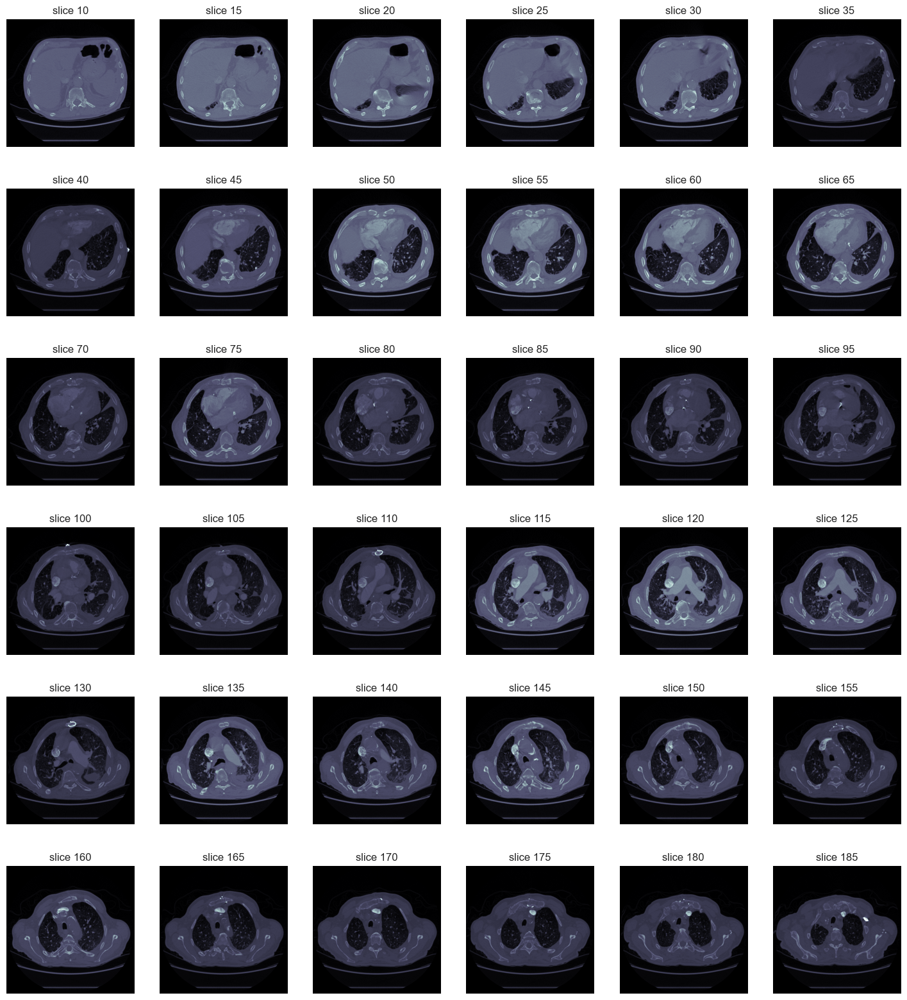

In [85]:
first_patient = load_slice('./input/rsna-str-pulmonary-embolism-detection/train/0a5dc64cf7b8/f6cbad104660')
first_patient_pixels = transform_to_hu(first_patient)

def sample_stack(stack, rows=6, cols=6, start_with=10, show_every=5):
    fig,ax = plt.subplots(rows,cols,figsize=[18,20])
    for i in range(rows*cols):
        ind = start_with + i*show_every
        ax[int(i/rows),int(i % rows)].set_title(f'slice {ind}')
        ax[int(i/rows),int(i % rows)].imshow(stack[ind],cmap='bone')
        ax[int(i/rows),int(i % rows)].axis('off')
    plt.show()

sample_stack(first_patient_pixels)

Lossy conversion from int16 to uint8. Range [-1024, 3071]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from int16 to uint8. Range [-1024, 3071]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from int16 to uint8. Range [-1024, 3071]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from int16 to uint8. Range [-1024, 3071]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from int16 to uint8. Range [-1024, 3071]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from int16 to uint8. Range [-1024, 1726]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from int16 to uint8. Range [-1024, 1369]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from int16 to uint8. Range [-1024, 1389]. Convert image to uint8 prior to saving to suppress this warning.
Lossy co

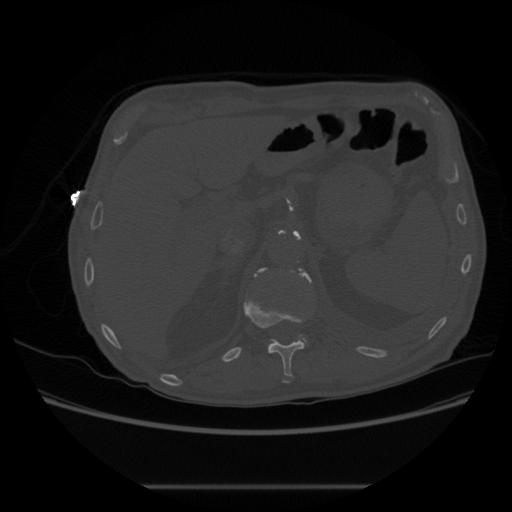

In [86]:
imageio.mimsave("/tmp/gif.gif", first_patient_pixels, duration=0.1)
display.Image(filename="/tmp/gif.gif", format='png')

image.shape (220, 512, 512)
scan.shape (220,)
spacing [2.         0.67773438 0.67773438]
resize_factor = spacing / new_spacing [2.         0.67773438 0.67773438]
new_real_shape = image.shape * resize_factor [440. 347. 347.]
new_shape = np.round(new_real_shape) [440. 347. 347.]
real_resize_factor = new_shape / image.shape [2.         0.67773438 0.67773438]
new_spacing = spacing / real_resize_factor [1. 1. 1.]
Drawing


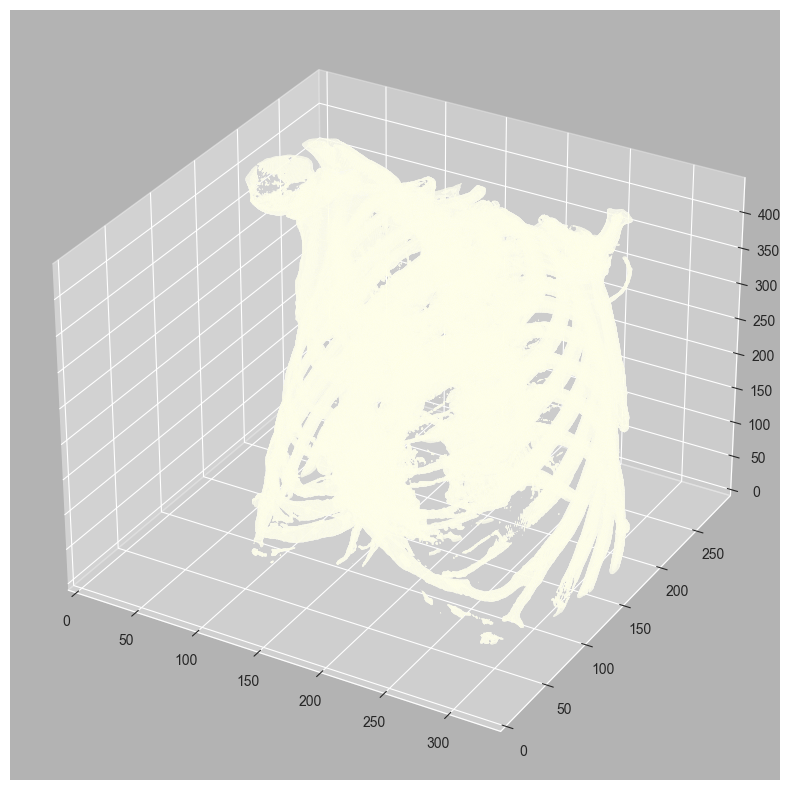

In [99]:
first_patient_scan = './input/rsna-str-pulmonary-embolism-detection/train/0a5dc64cf7b8/f6cbad104660'
scans_0 = load_scans(first_patient_scan)
imgs_after_resamp, spacing = resample(first_patient_pixels, scans_0, [1,1,1])
v, f = make_mesh(imgs_after_resamp, threshold = 350)
plt_3d(v, f)

In [50]:
im_path = []
train_path = './input/rsna-str-pulmonary-embolism-detection/train/'
path_list = [d for d in listdir(train_path) if not d.startswith('.')]
for i in path_list: 
    for j in listdir(train_path + i):
        if not j.startswith('.'):
            x = i+'/'+j
            im_path.append(x)

In [51]:
im_path

['df06fad17bc3/857e3d760445',
 '0ca63c35c515/f57330b429c8',
 '1a9f14210712/df38510dfe75',
 '0fd0bd70b8a4/30070329b486',
 '1b7480deea73/1ae5a817d4dc',
 '00e7015490cb/291c07d4a7c0',
 '0e1639d96a02/6a6f7d5eb30c',
 '00c53115a9fa/849b49fee78a',
 '0dee8f269fa3/cbd3835b590f',
 '1bcc40143078/db1d1541e7c3',
 '0a5dc64cf7b8/f6cbad104660',
 '0bcc172d73dd/851a25d1e0b1',
 '0e1f7f17fd0a/e2b8bd552764',
 '1b70efeaa340/b62ae6fd1cec',
 '0d5f3216ec1a/8fad72a9331f',
 '0f5d42280886/c836d3f9712b',
 '1be4067309fc/c60519b066b9',
 '0a780dd0d52b/df56c2f76030',
 '1a9500773d55/7eb6e9e4cb51',
 '0cfc61e46f28/f7b9822a6b03',
 '0e67352bd5e1/cf8531e72180',
 '1b606ab567a5/7b17a4b51b9f',
 '1b9f7f141db9/b9b5af4632e4',
 '0baf3b9f8a24/b4f3297243d0',
 '1b36329a1c52/e760e49521ff',
 '0b2c88c2f00a/bec1b1d73f48',
 '0b0425dda4cc/29843553ef87',
 '0fa0267f346b/45cda10f5418',
 '0c88ac793f56/c4eae879440e',
 '0deccf05e7b6/7e13385c847f',
 '0c99e788baa0/352d6c80d38d']

In [53]:
def get_window_value(feature):
    if type(feature) == pydicom.multival.MultiValue:
        return np.int(feature[0])
    else:
        return np.int(feature)

pixelspacing_r = []
pixelspacing_c = []
slice_thicknesses = []
ids = []
id_pth = []
row_values = []
column_values = []
window_widths = []
window_levels = []
modality = []
kvp = []
table_height = []
x_ray_tube = []
exp = []
pos = []
tilt = []
bits = []
rescale_inter = []
rescale_slope = []
photometric_interpretation = []
convolution_kernel = [] 


for i in im_path:
    ids.append(i.split('/')[0]+'_'+i.split('/')[1])
    example_dcm = listdir(train_path  + i + "/")[0]
    id_pth.append(train_path + i)
    dataset = pydicom.dcmread(train_path + i + "/" + example_dcm)
    
    window_widths.append(get_window_value(dataset.WindowWidth))
    window_levels.append(get_window_value(dataset.WindowCenter))
    
    spacing = dataset.PixelSpacing
    slice_thicknesses.append(dataset.SliceThickness)
    
    row_values.append(dataset.Rows)
    column_values.append(dataset.Columns)
    pixelspacing_r.append(spacing[0])
    pixelspacing_c.append(spacing[1])
    
    modality.append(dataset.Modality)
    kvp.append(dataset.KVP)
    table_height.append(dataset.TableHeight)
    x_ray_tube.append(dataset.XRayTubeCurrent)
    exp.append(dataset.Exposure)
    pos.append(dataset.PatientPosition)
    tilt.append(dataset.GantryDetectorTilt)
    bits.append(dataset.BitsAllocated)
    rescale_inter.append(dataset.RescaleIntercept)
    rescale_slope.append(dataset.RescaleSlope)
    photometric_interpretation.append(dataset.PhotometricInterpretation)
    convolution_kernel.append(dataset.ConvolutionKernel)
    
scan_properties = pd.DataFrame(data=ids, columns=["ID"])
scan_properties.loc[:, "rows"] = row_values
scan_properties.loc[:, "columns"] = column_values
scan_properties.loc[:, "area"] = scan_properties["rows"] * scan_properties["columns"]
scan_properties.loc[:, "pixelspacing_r"] = pixelspacing_r
scan_properties.loc[:, "pixelspacing_c"] = pixelspacing_c
scan_properties.loc[:, "pixelspacing_area"] = scan_properties.pixelspacing_r * scan_properties.pixelspacing_c
scan_properties.loc[:, "slice_thickness"] = slice_thicknesses
scan_properties.loc[:, "id_pth"] = id_pth
scan_properties.loc[:, "window_width"] = window_widths
scan_properties.loc[:, "window_level"] = window_levels
scan_properties.loc[:, "modality"] = modality
scan_properties.loc[:, "kvp"] = kvp
scan_properties.loc[:, "table_height"] = table_height
scan_properties.loc[:, "x_ray_tube_current"] = x_ray_tube
scan_properties.loc[:, "exposure"] = exp 
scan_properties.loc[:,"patient_position"] = pos
scan_properties.loc[:,"detector_tilt"] = tilt
scan_properties.loc[:,"bits_allocated"] = bits
scan_properties.loc[:,"rescale_intercept"] = rescale_inter
scan_properties.loc[:, "rescale_slope"] = rescale_slope
scan_properties.loc[:, "photometric_interpretation"] = photometric_interpretation
scan_properties.loc[:, "convolution_kernel"] = convolution_kernel

scan_properties.head().T

,0,1,2,3,4
ID,df06fad17bc3_857e3d760445,0ca63c35c515_f57330b429c8,1a9f14210712_df38510dfe75,0fd0bd70b8a4_30070329b486,1b7480deea73_1ae5a817d4dc
rows,512,512,512,512,512
columns,512,512,512,512,512
area,262144,262144,262144,262144,262144
pixelspacing_r,0.677734,0.597656,0.644531,0.859375,0.644531
pixelspacing_c,0.677734,0.597656,0.644531,0.859375,0.644531
pixelspacing_area,0.459324,0.357193,0.41542,0.738525,0.41542
slice_thickness,2.0,1.25,1.25,1.25,1.25
id_pth,./input/rsna-str-pulmonary-embolism-detection/...,./input/rsna-str-pulmonary-embolism-detection/...,./input/rsna-str-pulmonary-embolism-detection/...,./input/rsna-str-pulmonary-embolism-detection/...,./input/rsna-str-pulmonary-embolism-detection/...
window_width,350,400,350,350,350


['0.677734375', '0.59765625', '0.644531', '0.859375', '0.644531', '0.68359375', '0.707031', '0.56640625', '0.650391', '0.644531', '0.722656', '0.679688', '0.685547', '0.767578', '0.677734375', '0.71875', '0.68359375', '0.734375', '0.53125', '0.625', '0.589844', '0.68359375', '0.68359375', '0.775391', '0.976562', '0.68359375', '0.6875', '0.779297', '0.744140625', '0.646484375', '0.619141']


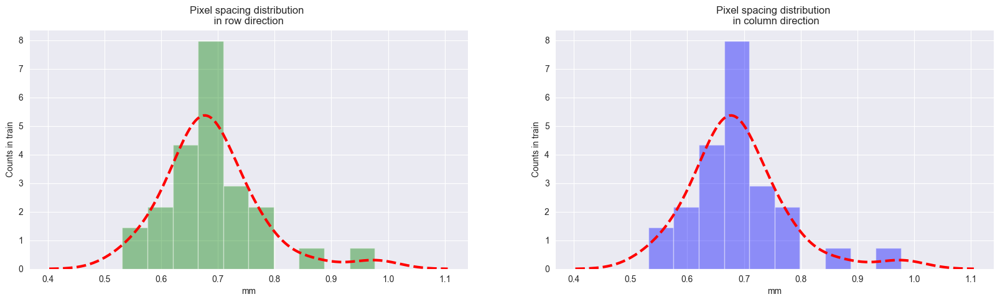

In [56]:
print(pixelspacing_r)
sns.set_style('darkgrid')
fig, ax = plt.subplots(1,2,figsize=(20,5))
sns.distplot(pixelspacing_r, ax=ax[0], color='green', kde_kws=dict(lw=3, ls="--",color='red'))
ax[0].set_title("Pixel spacing distribution \n in row direction ")
ax[0].set_ylabel("Counts in train")
ax[0].set_xlabel("mm")
sns.distplot(pixelspacing_c, ax=ax[1], color="Blue",kde_kws=dict(lw=3, ls="--",color='red'))
ax[1].set_title("Pixel spacing distribution \n in column direction");
ax[1].set_ylabel("Counts in train");
ax[1].set_xlabel("mm");

In [57]:
scan_properties["r_distance"] = scan_properties.pixelspacing_r * scan_properties.rows
scan_properties["c_distance"] = scan_properties.pixelspacing_c * scan_properties["columns"]
scan_properties["area_cm2"] = 0.1* scan_properties["r_distance"] * 0.1*scan_properties["c_distance"]
scan_properties["slice_volume_cm3"] = 0.1*scan_properties.slice_thickness * scan_properties.area_cm2

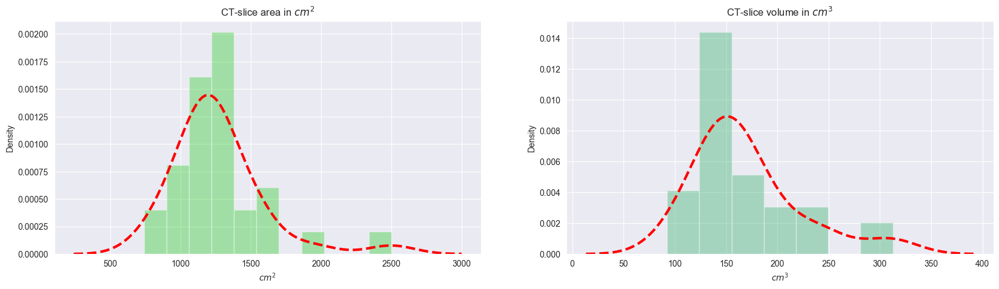

In [58]:
fig, ax = plt.subplots(1,2,figsize=(20,5))
sns.distplot(scan_properties.area_cm2, ax=ax[0], color="Limegreen",kde_kws=dict(lw=3, ls="--",color='red'))
sns.distplot(scan_properties.slice_volume_cm3, ax=ax[1], color="Mediumseagreen",kde_kws=dict(lw=3, ls="--",color='red'))
ax[0].set_title("CT-slice area in $cm^{2}$")
ax[1].set_title("CT-slice volume in $cm^{3}$")
ax[0].set_xlabel("$cm^{2}$")
ax[1].set_xlabel("$cm^{3}$");

In [59]:
scan_properties.head(3).T

,0,1,2
ID,df06fad17bc3_857e3d760445,0ca63c35c515_f57330b429c8,1a9f14210712_df38510dfe75
rows,512,512,512
columns,512,512,512
area,262144,262144,262144
pixelspacing_r,0.677734,0.597656,0.644531
pixelspacing_c,0.677734,0.597656,0.644531
pixelspacing_area,0.459324,0.357193,0.41542
slice_thickness,2.0,1.25,1.25
id_pth,./input/rsna-str-pulmonary-embolism-detection/...,./input/rsna-str-pulmonary-embolism-detection/...,./input/rsna-str-pulmonary-embolism-detection/...
window_width,350,400,350


In [60]:
scan_properties.describe().T

,count,mean,std,min,25%,50%,75%,max
rows,31.0,512.000000,0.000000,512.000000,512.000000,512.000000,512.000000,512.000000
columns,31.0,512.000000,0.000000,512.000000,512.000000,512.000000,512.000000,512.000000
area,31.0,262144.000000,0.000000,262144.000000,262144.000000,262144.000000,262144.000000,262144.000000
pixelspacing_r,31.0,0.689390,0.085195,0.531250,0.644531,0.683594,0.720703,0.976562
pixelspacing_c,31.0,0.689390,0.085195,0.531250,0.644531,0.683594,0.720703,0.976562
pixelspacing_area,31.0,0.482283,0.126807,0.282227,0.415420,0.467300,0.519417,0.953673
slice_thickness,31.0,1.354839,0.358086,1.250000,1.250000,1.250000,1.250000,3.000000
window_width,31.0,375.935484,64.333473,350.000000,350.000000,350.000000,400.000000,700.000000
window_level,31.0,41.935484,7.491931,40.000000,40.000000,40.000000,40.000000,80.000000
kvp,31.0,116.774194,9.087389,100.000000,120.000000,120.000000,120.000000,140.000000
